# Under-represented class selection
One way to do selection of images is to specifically search for 'under-represented classes'. Neural networks learn what you feed them, and actually struggle recognizing classes if the distribution in number of samples is tilted. More concretely: if you rarely show way more bikes than cars to a neural network you will have a better performance on cars than on bikes. 

It's best to keep the classes equal, but that begs the question: what images should you send to annotation, and how do you find these? 

An obvious solution is to use a trained neural network to find the images which contain these under-represented classes, and that's what I will demonstrate in this notebook. 


In [1]:
#import tensorflow as tf

## Download the neural network
In this notebook I will use the ImageAI library. It's a simple library which makes working with images really simple. We will use a neural network which is pre-trained on the coco dataset to detect specific objects in images: 
`wget https://github.com/OlafenwaMoses/ImageAI/releases/download/essentials-v5/resnet50_coco_best_v2.1.0.h5`

Unfortunately the predictions by this network are not going to be perfect (otherwise the self-driving car problem would be solved!), especially as the network we run inference with is not trained on this specific data. 

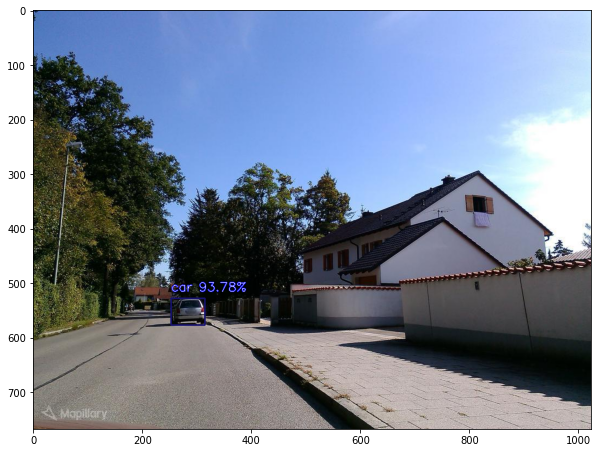

{'name': 'car', 'percentage_probability': 93.78069639205933, 'box_points': [253, 528, 315, 577]}


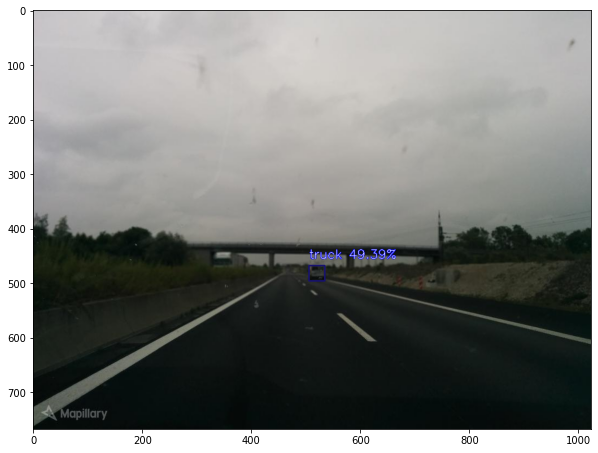

{'name': 'truck', 'percentage_probability': 49.392324686050415, 'box_points': [506, 468, 535, 496]}


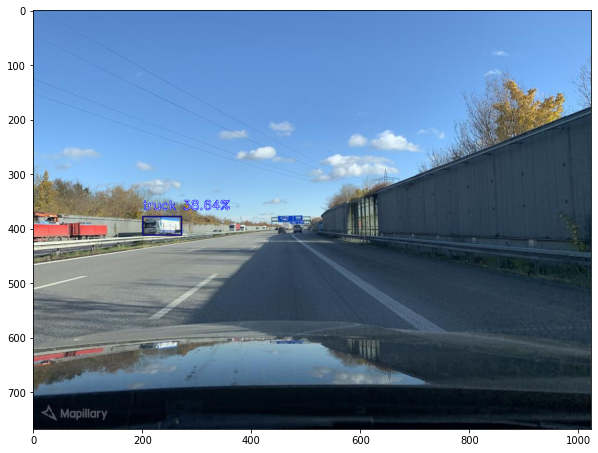

{'name': 'truck', 'percentage_probability': 38.64467144012451, 'box_points': [201, 378, 272, 412]}


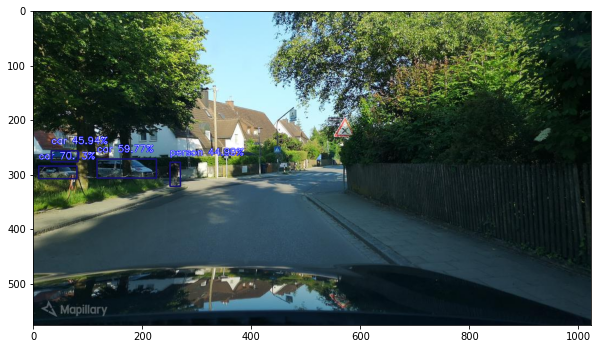

{'name': 'car', 'percentage_probability': 70.13396620750427, 'box_points': [10, 284, 80, 307]}
{'name': 'car', 'percentage_probability': 59.76700186729431, 'box_points': [117, 271, 226, 306]}
{'name': 'car', 'percentage_probability': 45.93602120876312, 'box_points': [33, 256, 82, 276]}
{'name': 'person', 'percentage_probability': 44.98510658740997, 'box_points': [251, 277, 270, 321]}


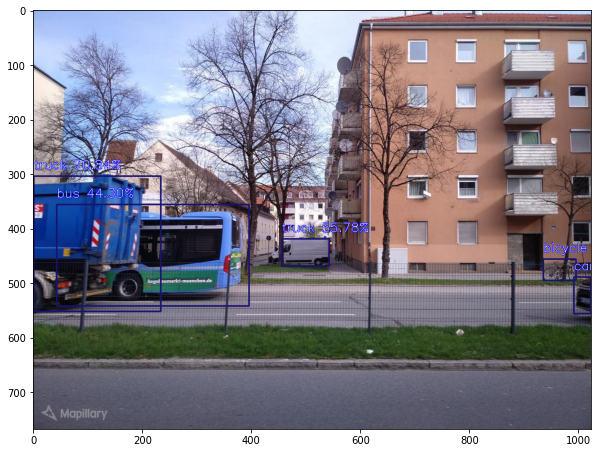

{'name': 'bicycle', 'percentage_probability': 86.11297607421875, 'box_points': [936, 456, 996, 495]}
{'name': 'truck', 'percentage_probability': 70.84201574325562, 'box_points': [1, 304, 234, 552]}
{'name': 'car', 'percentage_probability': 66.09145998954773, 'box_points': [992, 489, 1023, 556]}
{'name': 'truck', 'percentage_probability': 55.77728748321533, 'box_points': [456, 419, 543, 469]}
{'name': 'bus', 'percentage_probability': 44.29953396320343, 'box_points': [43, 356, 396, 542]}


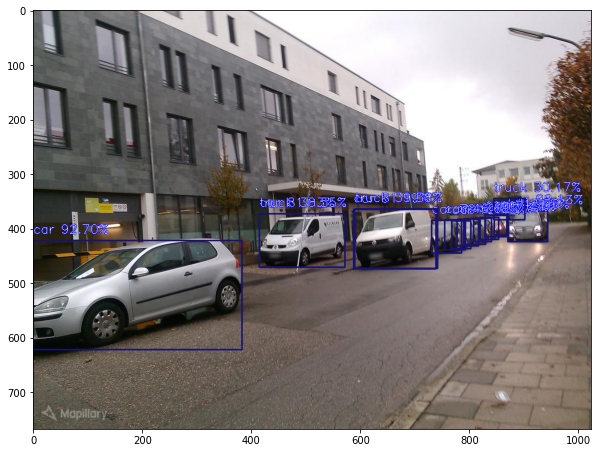

{'name': 'car', 'percentage_probability': 92.70387291908264, 'box_points': [0, 422, 383, 622]}
{'name': 'car', 'percentage_probability': 88.1291151046753, 'box_points': [871, 368, 944, 424]}
{'name': 'car', 'percentage_probability': 81.83119297027588, 'box_points': [415, 373, 572, 471]}
{'name': 'car', 'percentage_probability': 81.36286735534668, 'box_points': [790, 382, 830, 429]}
{'name': 'car', 'percentage_probability': 81.18511438369751, 'box_points': [588, 365, 739, 474]}
{'name': 'car', 'percentage_probability': 81.01472854614258, 'box_points': [778, 383, 817, 432]}
{'name': 'car', 'percentage_probability': 79.03999090194702, 'box_points': [731, 385, 786, 445]}
{'name': 'car', 'percentage_probability': 76.1338472366333, 'box_points': [808, 381, 841, 424]}
{'name': 'car', 'percentage_probability': 72.42807149887085, 'box_points': [768, 386, 803, 437]}
{'name': 'car', 'percentage_probability': 71.90312147140503, 'box_points': [829, 375, 869, 415]}
{'name': 'car', 'percentage_probab

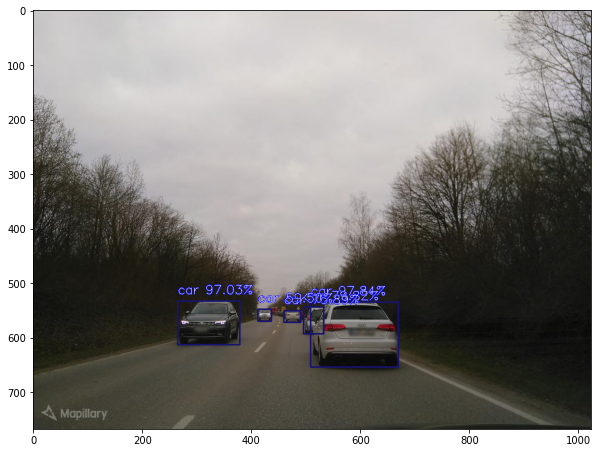

{'name': 'car', 'percentage_probability': 97.8358268737793, 'box_points': [509, 535, 670, 654]}
{'name': 'car', 'percentage_probability': 97.02869057655334, 'box_points': [265, 533, 379, 613]}
{'name': 'car', 'percentage_probability': 79.82133030891418, 'box_points': [496, 544, 533, 593]}
{'name': 'car', 'percentage_probability': 75.89394450187683, 'box_points': [460, 551, 491, 572]}
{'name': 'car', 'percentage_probability': 59.49808359146118, 'box_points': [412, 548, 437, 570]}


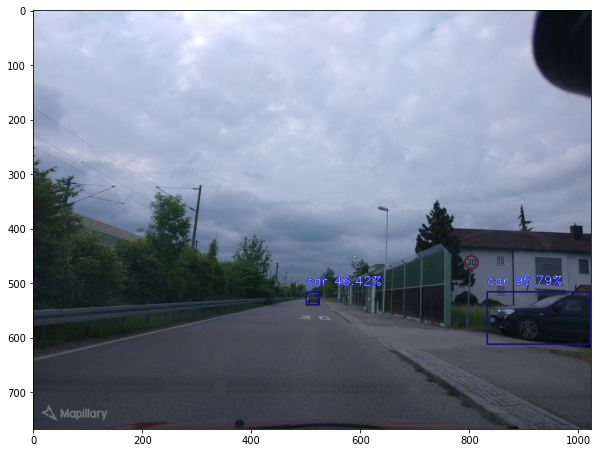

{'name': 'car', 'percentage_probability': 95.78561782836914, 'box_points': [833, 516, 1022, 612]}
{'name': 'car', 'percentage_probability': 46.41607403755188, 'box_points': [501, 517, 525, 540]}


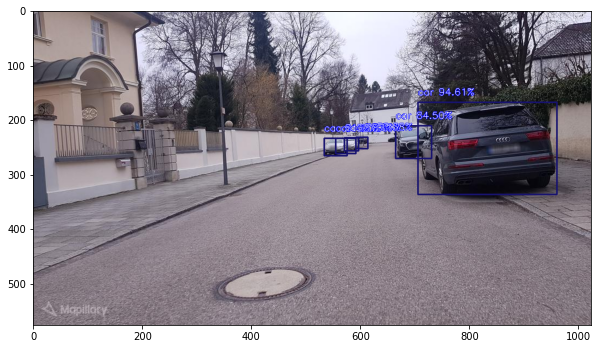

{'name': 'car', 'percentage_probability': 94.61014866828918, 'box_points': [706, 167, 961, 336]}
{'name': 'car', 'percentage_probability': 84.49738025665283, 'box_points': [665, 210, 731, 270]}
{'name': 'car', 'percentage_probability': 81.90448880195618, 'box_points': [534, 233, 576, 265]}
{'name': 'car', 'percentage_probability': 73.68609309196472, 'box_points': [571, 232, 597, 256]}
{'name': 'car', 'percentage_probability': 50.37561058998108, 'box_points': [592, 231, 614, 252]}
{'name': 'car', 'percentage_probability': 32.86724090576172, 'box_points': [555, 233, 592, 261]}


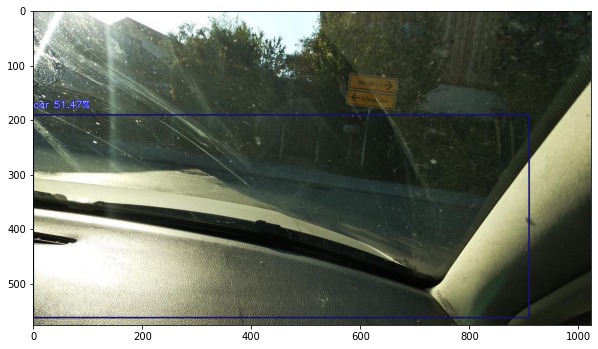

{'name': 'car', 'percentage_probability': 51.46705508232117, 'box_points': [0, 190, 910, 562]}


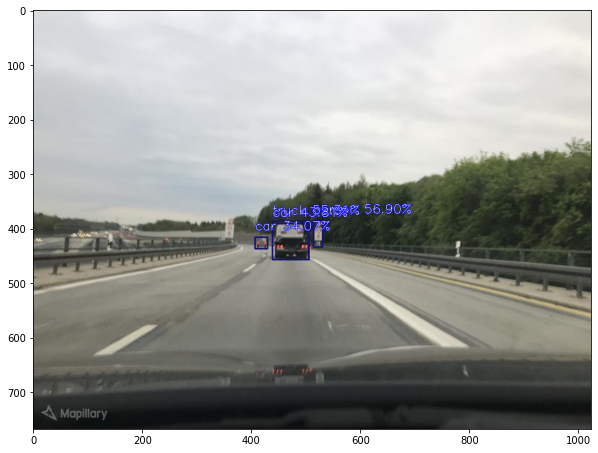

{'name': 'person', 'percentage_probability': 56.90082311630249, 'box_points': [514, 385, 531, 434]}
{'name': 'truck', 'percentage_probability': 55.314064025878906, 'box_points': [439, 387, 505, 457]}
{'name': 'car', 'percentage_probability': 43.80892515182495, 'box_points': [439, 391, 506, 457]}
{'name': 'car', 'percentage_probability': 34.06811058521271, 'box_points': [407, 416, 430, 437]}


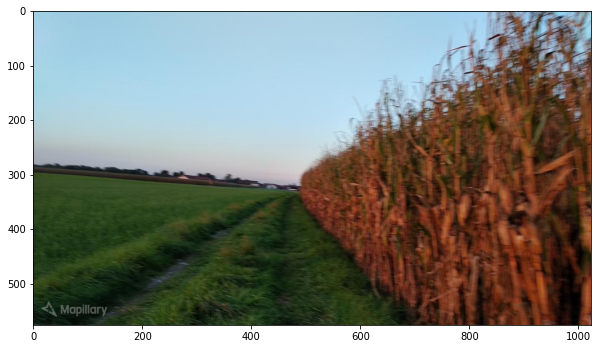

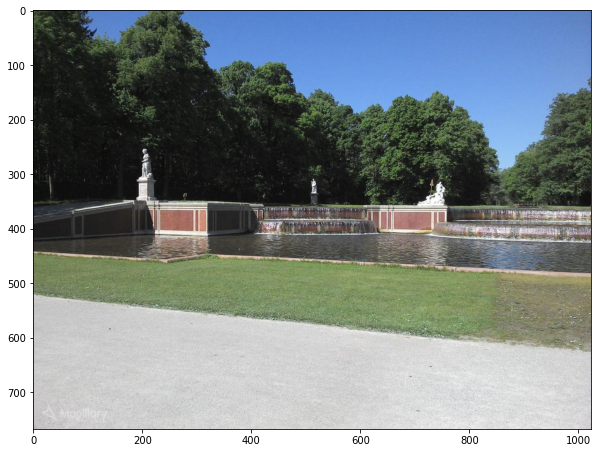

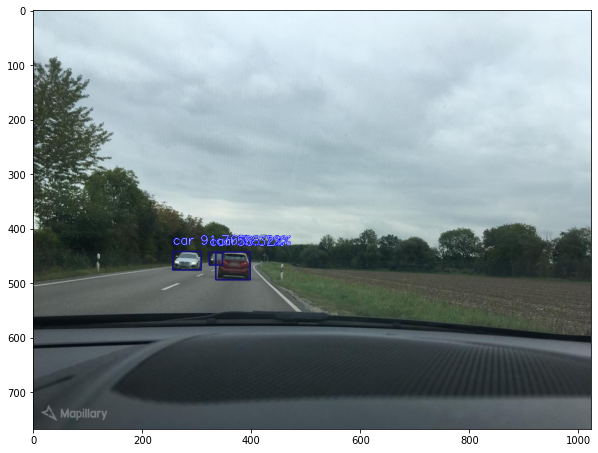

{'name': 'car', 'percentage_probability': 91.75735116004944, 'box_points': [256, 442, 308, 476]}
{'name': 'car', 'percentage_probability': 88.71934413909912, 'box_points': [335, 443, 398, 494]}
{'name': 'car', 'percentage_probability': 56.31524920463562, 'box_points': [323, 444, 347, 467]}


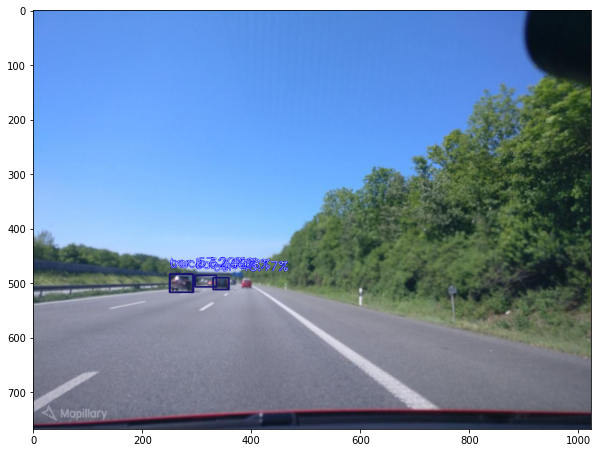

{'name': 'car', 'percentage_probability': 57.223016023635864, 'box_points': [251, 483, 293, 517]}
{'name': 'car', 'percentage_probability': 48.17038178443909, 'box_points': [330, 490, 359, 512]}
{'name': 'car', 'percentage_probability': 39.67583179473877, 'box_points': [297, 486, 336, 507]}
{'name': 'truck', 'percentage_probability': 32.417842745780945, 'box_points': [250, 484, 294, 517]}


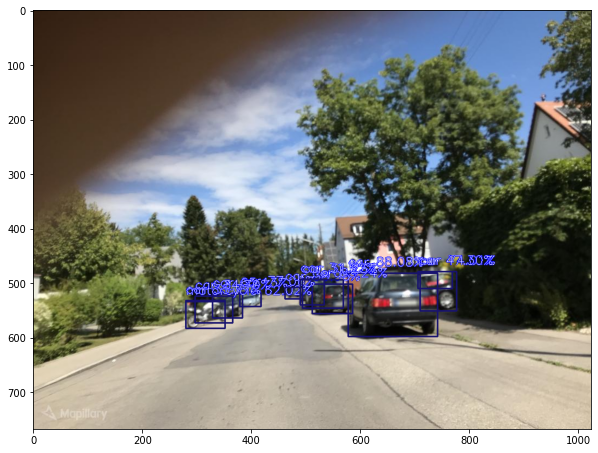

{'name': 'car', 'percentage_probability': 88.08144330978394, 'box_points': [578, 482, 742, 598]}
{'name': 'car', 'percentage_probability': 83.23601484298706, 'box_points': [512, 502, 586, 556]}
{'name': 'car', 'percentage_probability': 77.06003189086914, 'box_points': [379, 517, 418, 543]}
{'name': 'car', 'percentage_probability': 74.01180267333984, 'box_points': [710, 479, 777, 551]}
{'name': 'car', 'percentage_probability': 65.13439416885376, 'box_points': [329, 520, 384, 564]}
{'name': 'motorcycle', 'percentage_probability': 62.016963958740234, 'box_points': [280, 534, 352, 583]}
{'name': 'car', 'percentage_probability': 47.29689657688141, 'box_points': [706, 479, 769, 510]}
{'name': 'car', 'percentage_probability': 38.95118534564972, 'box_points': [462, 508, 490, 529]}
{'name': 'car', 'percentage_probability': 35.76733469963074, 'box_points': [280, 532, 352, 583]}
{'name': 'car', 'percentage_probability': 34.698811173439026, 'box_points': [297, 524, 366, 573]}
{'name': 'car', 'perc

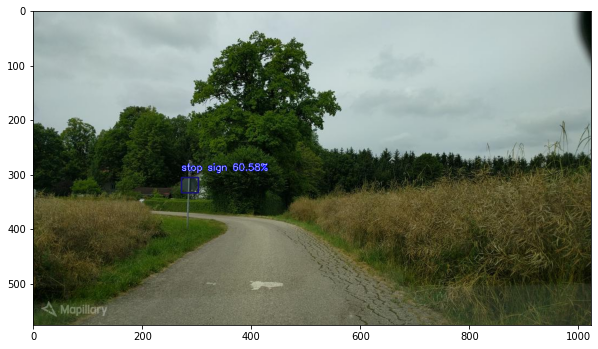

{'name': 'stop sign', 'percentage_probability': 60.57502031326294, 'box_points': [272, 305, 303, 333]}


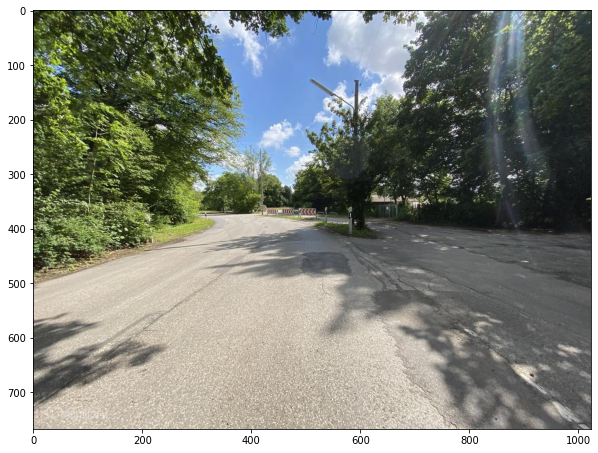

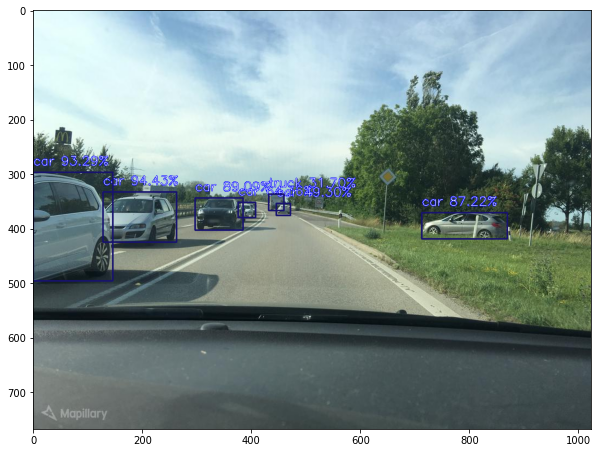

{'name': 'car', 'percentage_probability': 94.4260835647583, 'box_points': [128, 333, 263, 425]}
{'name': 'car', 'percentage_probability': 93.29499006271362, 'box_points': [0, 297, 146, 496]}
{'name': 'car', 'percentage_probability': 89.09011483192444, 'box_points': [297, 344, 385, 403]}
{'name': 'car', 'percentage_probability': 87.21970319747925, 'box_points': [713, 371, 870, 419]}
{'name': 'car', 'percentage_probability': 64.36447501182556, 'box_points': [376, 352, 408, 380]}
{'name': 'car', 'percentage_probability': 49.30121600627899, 'box_points': [446, 354, 472, 376]}
{'name': 'truck', 'percentage_probability': 31.701472401618958, 'box_points': [432, 337, 460, 367]}


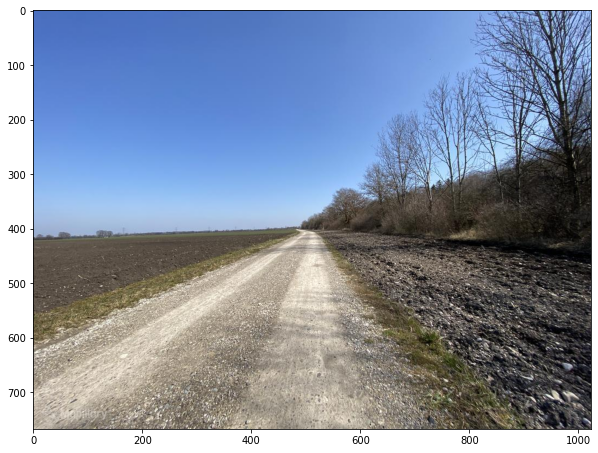

In [15]:
from imageai.Detection import ObjectDetection
from collections import Counter, defaultdict
import matplotlib.pyplot as plt
import tqdm
import os
import cv2

folder = '/datasets/mappilary_scrape/images'

execution_path = os.getcwd()

detector = ObjectDetection()
detector.setModelTypeAsRetinaNet()
detector.setModelPath( os.path.join(execution_path , "resnet50_coco_best_v2.1.0.h5"))
detector.loadModel()

## Data inspection
Let's take a look at what objects are detected, and with what quality. We will then run inference on a large number of images to get a feeling for how underrepresented certain classes are. 
When I ran this on a few images I got the following class distribution: 

car 3921

truck 717

person 607

bicycle 307

bus 137

motorcycle 84

train 34

In [21]:
number_classes = defaultdict(int)

for index, image in enumerate(tqdm.tqdm(os.listdir(folder)[:5000])):
    out_images, detections = detector.detectObjectsFromImage(input_image=os.path.join(folder , image), output_type="array", minimum_percentage_probability=30)

    # Visualise the first few images
    if index < 3: 
        im_rgb = cv2.cvtColor(out_images, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10,10))
        plt.imshow(im_rgb)
        plt.show()
        
    # Count all object classes to get a good feeling for how well balanced the dataset would be if we would randomly select images
    for eachObject in detections:
        number_classes[eachObject["name"]] += 1

 33%|███▎      | 1629/5000 [12:23<25:39,  2.19it/s]


ValueError: Ensure you specified correct input image, input type, output type and/or output image path 

In [25]:
number_classes

defaultdict(int,
            {'car': 3921,
             'truck': 717,
             'person': 607,
             'bicycle': 307,
             'bus': 137,
             'motorcycle': 84,
             'stop sign': 24,
             'traffic light': 119,
             'backpack': 24,
             'suitcase': 6,
             'bench': 43,
             'skateboard': 5,
             'chair': 9,
             'handbag': 12,
             'boat': 8,
             'parking meter': 4,
             'surfboard': 5,
             'frisbee': 6,
             'train': 34,
             'bear': 1,
             'bird': 10,
             'umbrella': 4,
             'clock': 5,
             'dining table': 1,
             'dog': 9,
             'cell phone': 1,
             'potted plant': 12,
             'fire hydrant': 4,
             'bottle': 2,
             'airplane': 6,
             'sheep': 3,
             'baseball bat': 1,
             'kite': 7,
             'cat': 2,
             'cow': 6,
             '

In [27]:
for class_name in number_classes:
    print(class_name, number_classes[class_name])

car 3921
truck 717
person 607
bicycle 307
bus 137
motorcycle 84
stop sign 24
traffic light 119
backpack 24
suitcase 6
bench 43
skateboard 5
chair 9
handbag 12
boat 8
parking meter 4
surfboard 5
frisbee 6
train 34
bear 1
bird 10
umbrella 4
clock 5
dining table 1
dog 9
cell phone 1
potted plant 12
fire hydrant 4
bottle 2
airplane 6
sheep 3
baseball bat 1
kite 7
cat 2
cow 6
horse 4
elephant 3
broccoli 1
keyboard 2
tv 1
bowl 1
remote 1
skis 1
refrigerator 1
sink 1


## Finding images with a specific class
The code below defines a few rare classes, and shows you images with those rare classes present. 

Detected the following objects in this image:  ['horse']


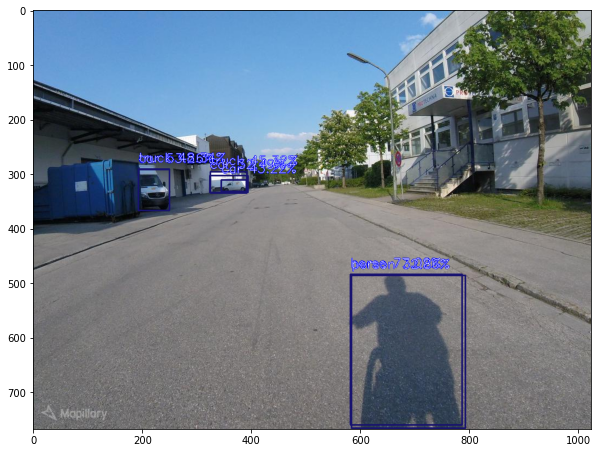

Detected the following objects in this image:  ['bird']


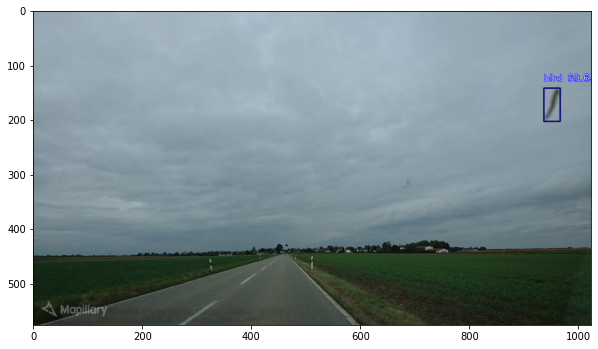

Detected the following objects in this image:  ['dog']


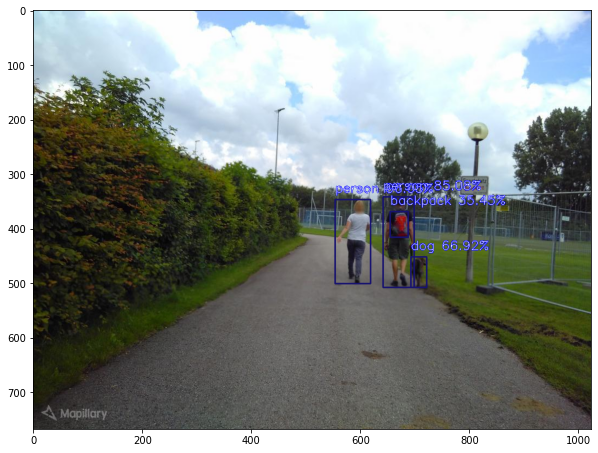

Detected the following objects in this image:  ['bird']


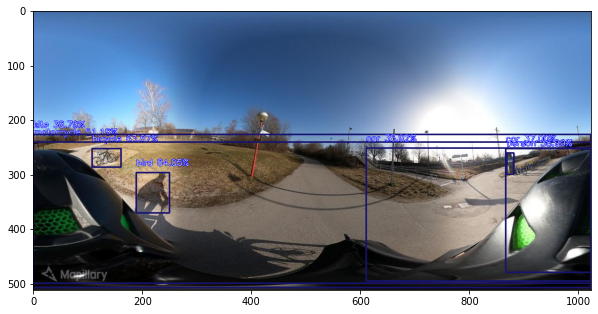

Detected the following objects in this image:  ['cow', 'horse', 'cow']


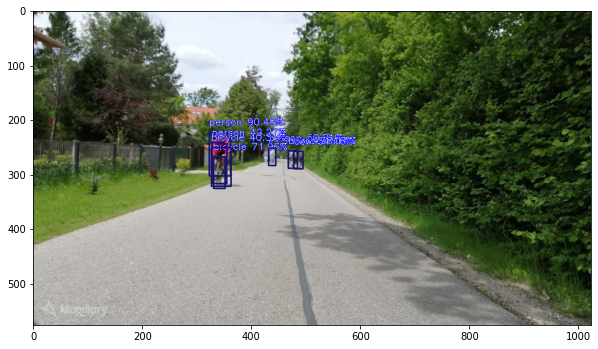

Detected the following objects in this image:  ['bird', 'horse']


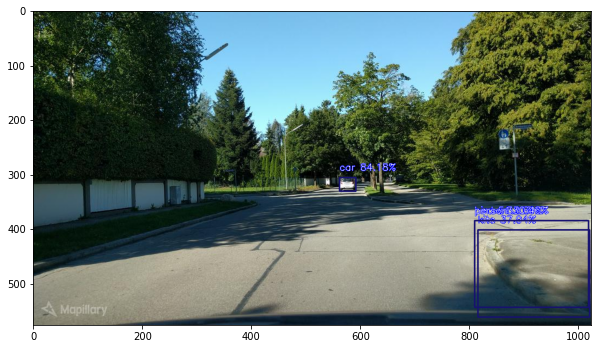

Detected the following objects in this image:  ['dog', 'sheep', 'dog', 'cow']


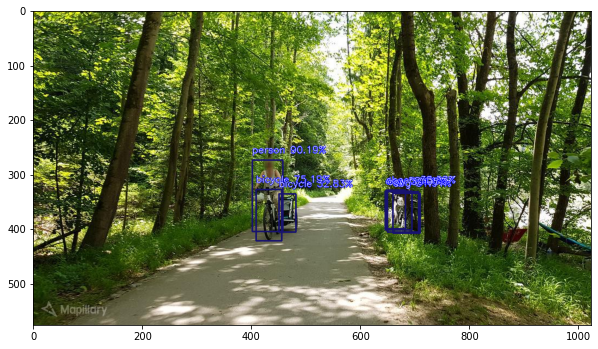

Detected the following objects in this image:  ['sheep']


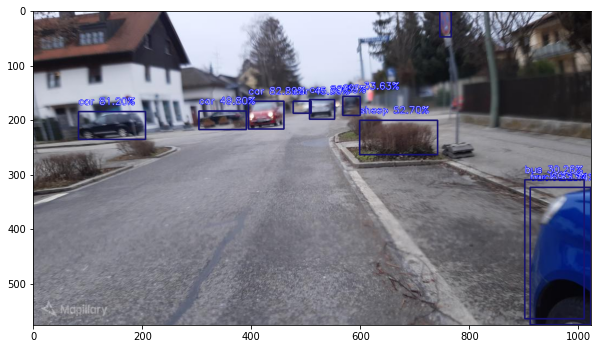

Detected the following objects in this image:  ['bird']


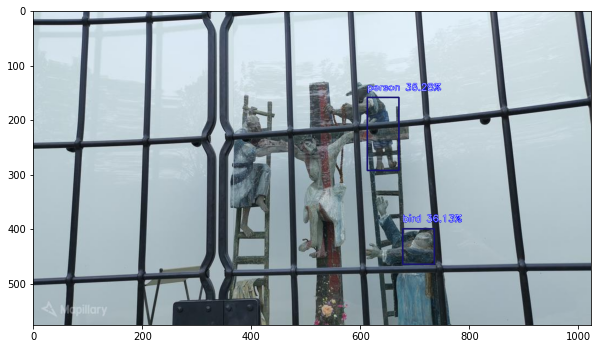

Detected the following objects in this image:  ['sheep', 'bird']


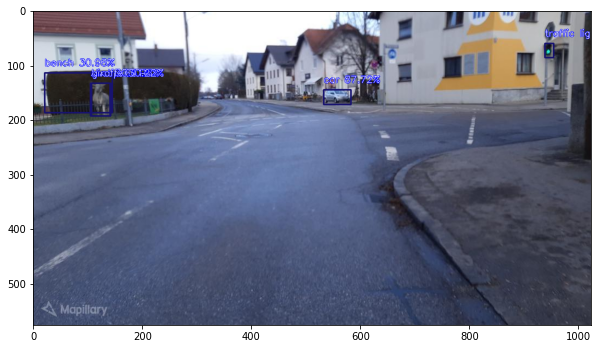

Detected the following objects in this image:  ['cow']


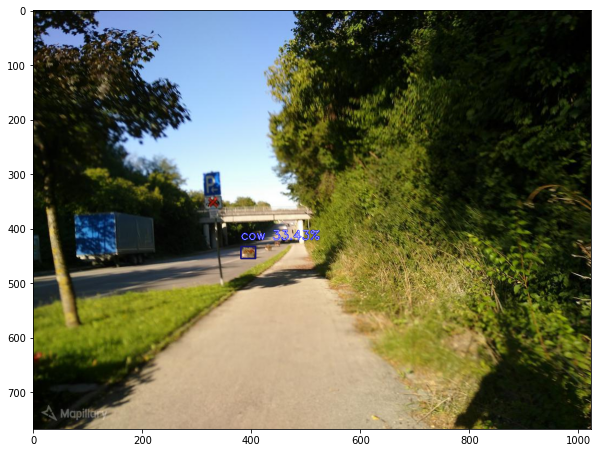

Detected the following objects in this image:  ['bird']


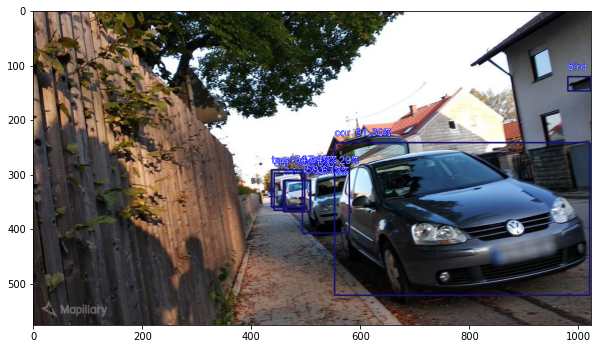

Detected the following objects in this image:  ['cow']


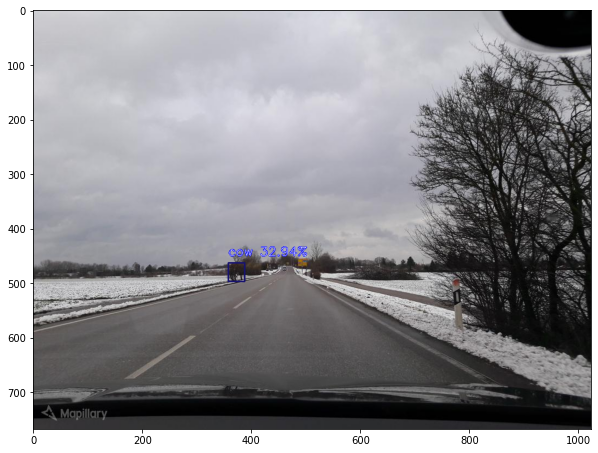

Detected the following objects in this image:  ['horse']


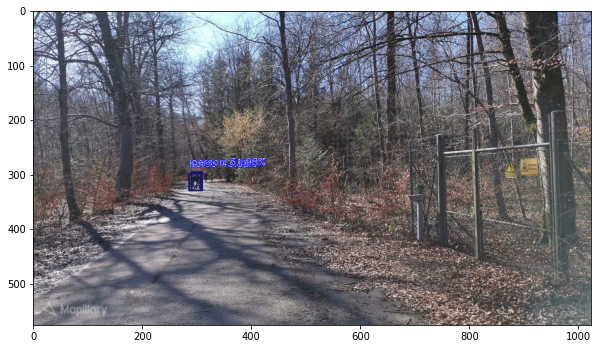

Detected the following objects in this image:  ['horse']


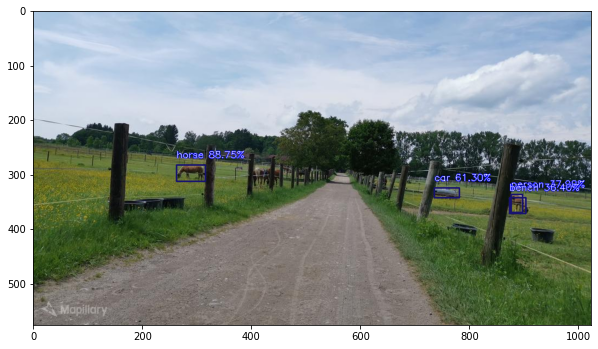

Detected the following objects in this image:  ['dog']


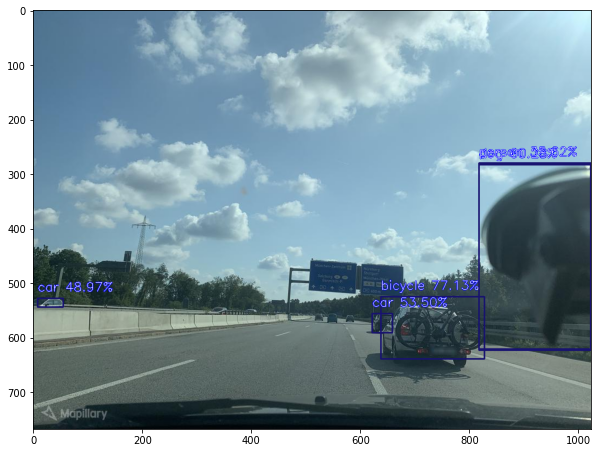

Detected the following objects in this image:  ['horse', 'horse', 'cow']


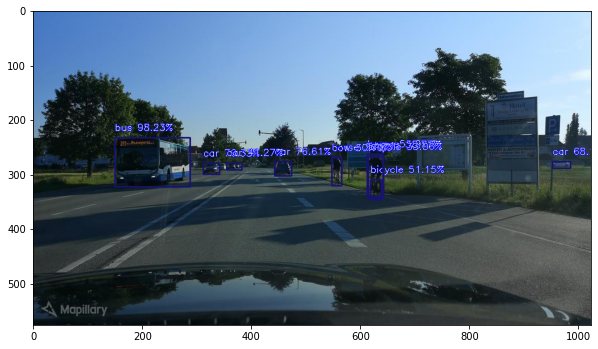

Detected the following objects in this image:  ['bird']


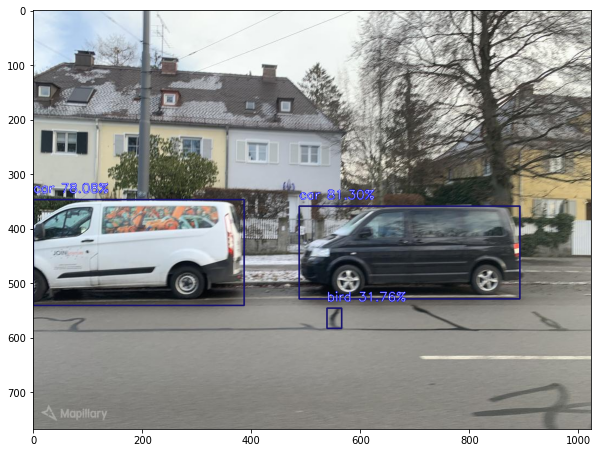

Detected the following objects in this image:  ['bear']


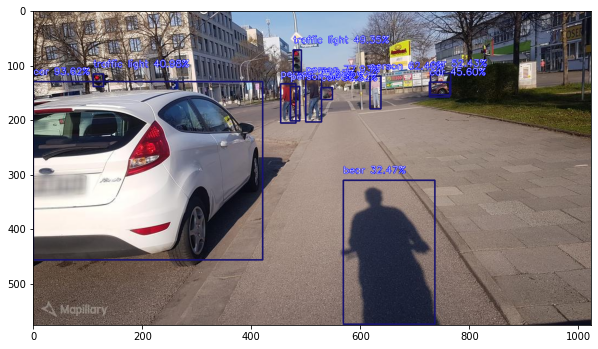

Detected the following objects in this image:  ['cow']


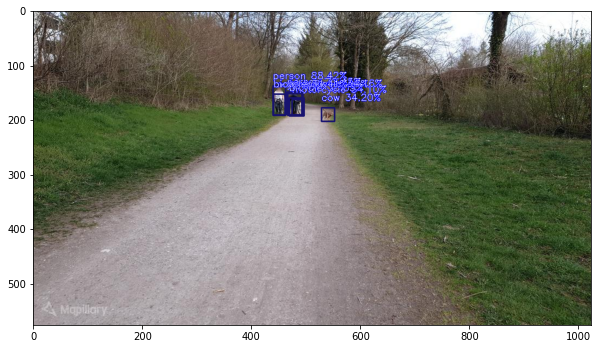

Detected the following objects in this image:  ['dog', 'bird']


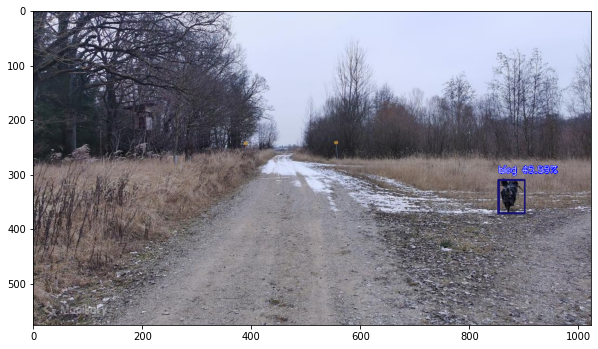

Detected the following objects in this image:  ['cow']


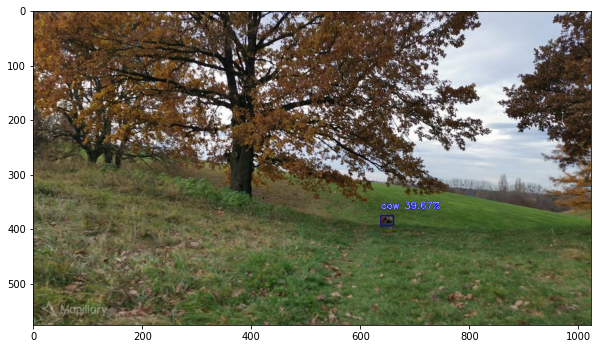

Detected the following objects in this image:  ['bird']


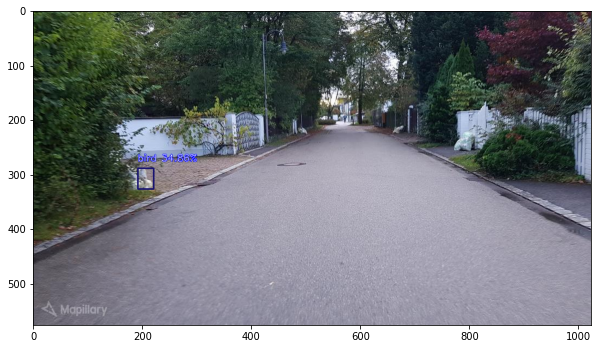

Detected the following objects in this image:  ['bird']


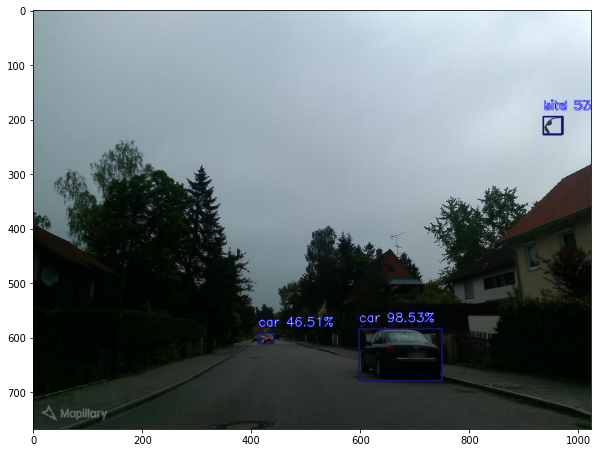

Detected the following objects in this image:  ['horse']


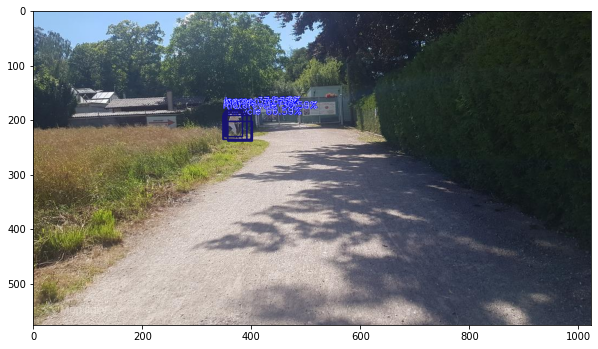

Detected the following objects in this image:  ['dog']


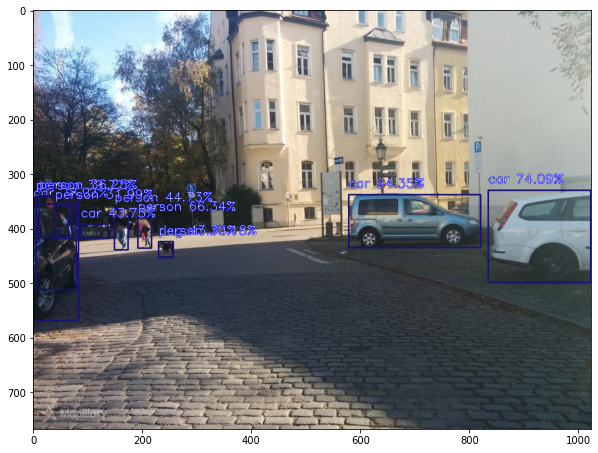

Detected the following objects in this image:  ['horse']


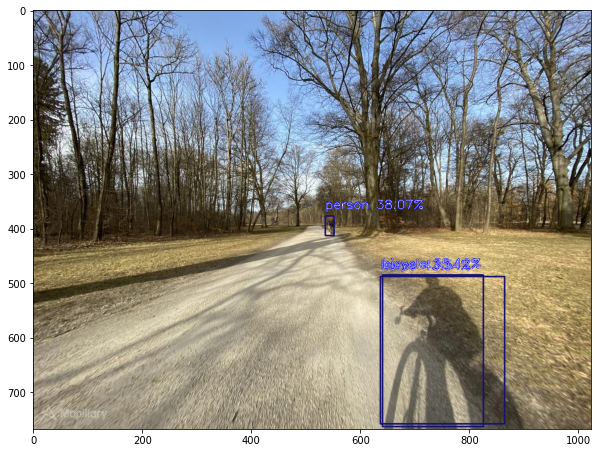

Detected the following objects in this image:  ['cow']


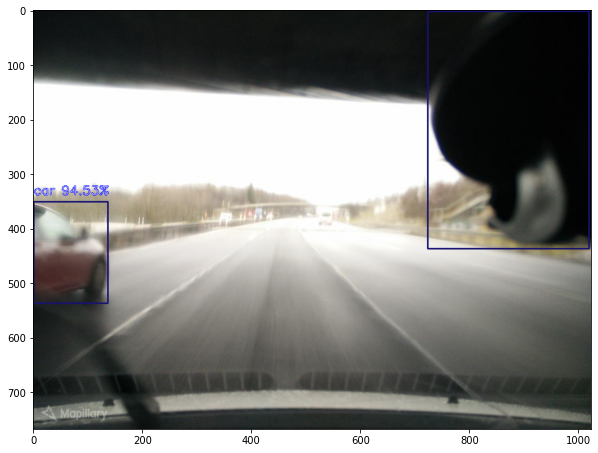

Detected the following objects in this image:  ['cow', 'bear']


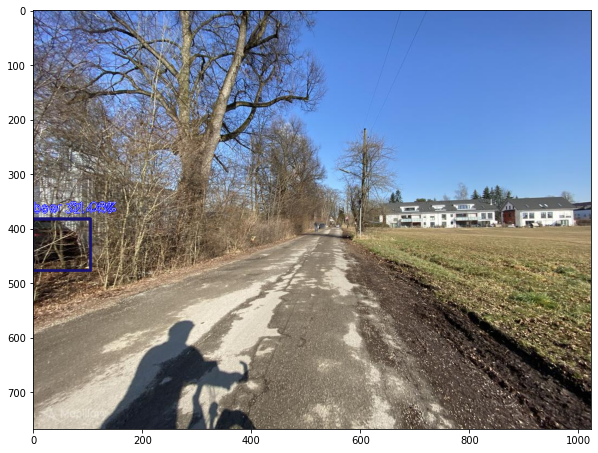

Detected the following objects in this image:  ['dog']


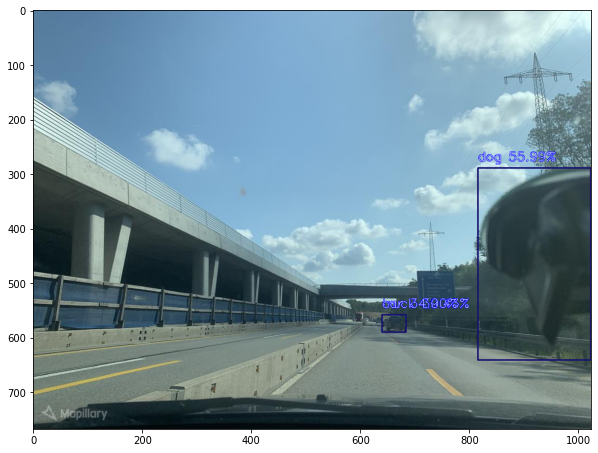

Detected the following objects in this image:  ['bird']


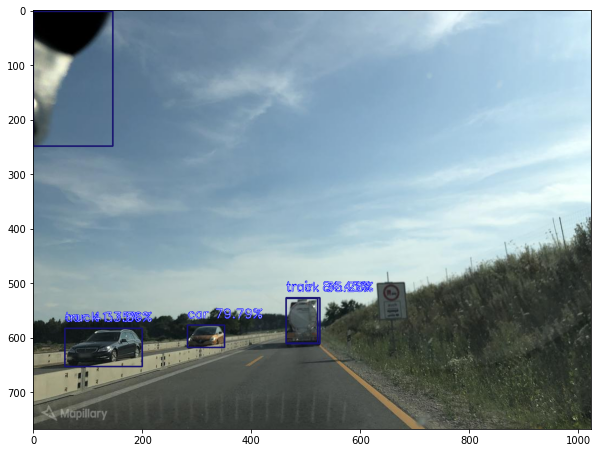

Detected the following objects in this image:  ['cow', 'horse', 'cow', 'horse']


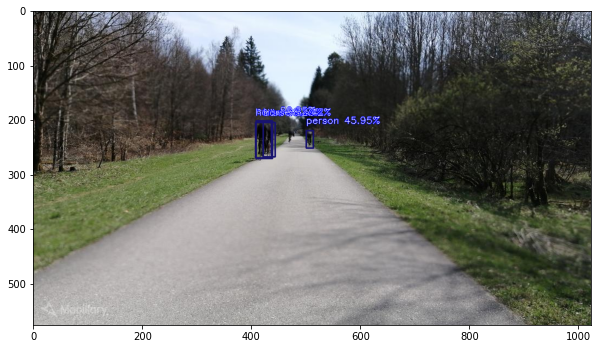

Detected the following objects in this image:  ['bird']


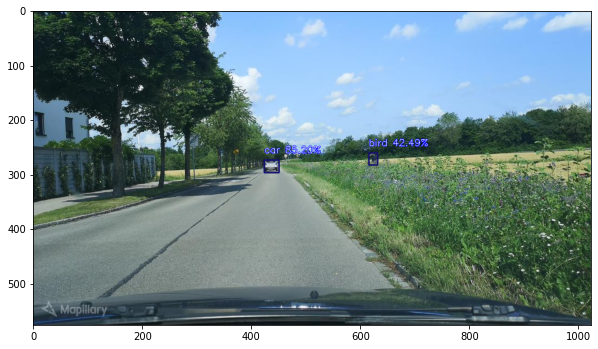

Detected the following objects in this image:  ['horse', 'horse']


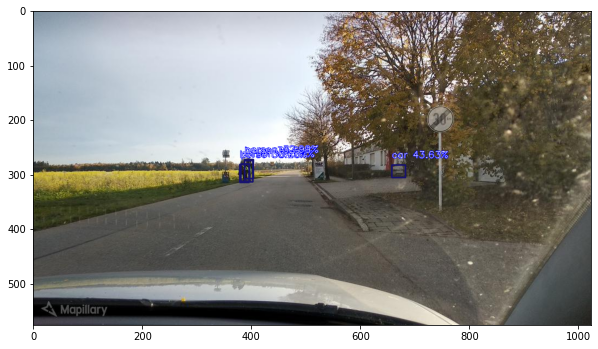

Detected the following objects in this image:  ['bird']


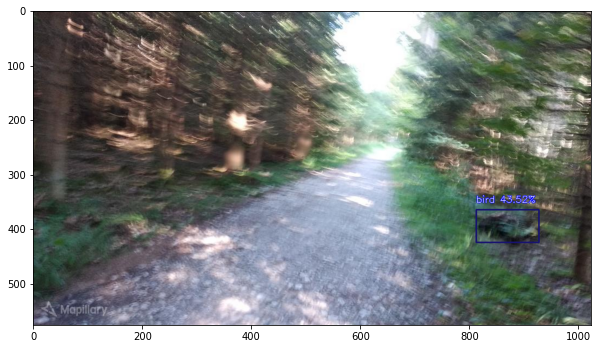

Detected the following objects in this image:  ['bear']


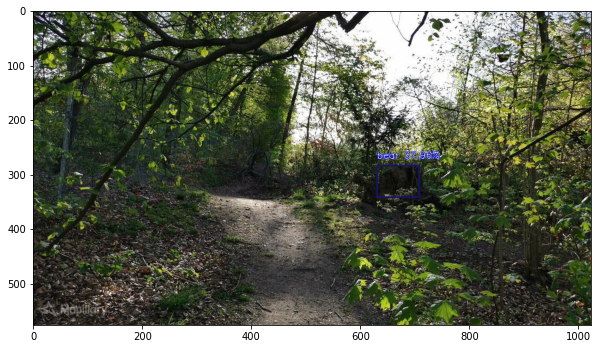

Detected the following objects in this image:  ['bird']


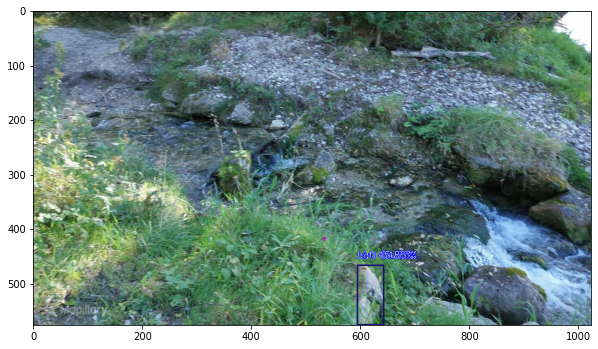

Detected the following objects in this image:  ['horse']


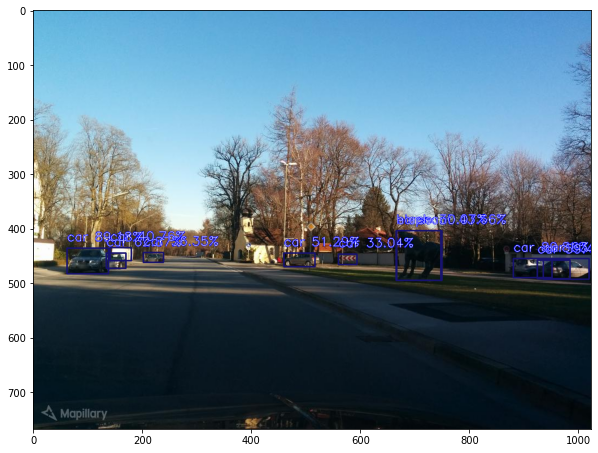

Detected the following objects in this image:  ['cow']


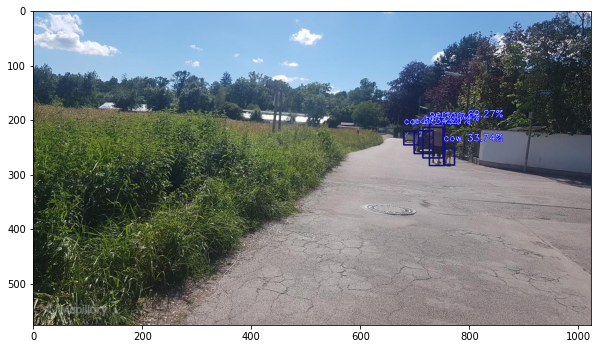

In [35]:
#rare_classes = ["bicycle", "motorcycle"]
rare_classes = ["dog", "horse", "cow", "sheep", "bear", "bird"]

number_classes = defaultdict(int)

for image in os.listdir(folder)[1000:5000]:
    out_image, detections = detector.detectObjectsFromImage(input_image=os.path.join(folder , image), output_type="array", minimum_percentage_probability=30)

    # Count all object classes to get a good feeling for how well balanced the dataset would be if we would randomly select images
    rare_detected = list()
    for eachObject in detections:
        if eachObject["name"] in rare_classes: 
            rare_detected.append(eachObject['name'])

    if len(rare_detected) > 0: 
        print("Detected the following objects in this image: ", rare_detected)
        im_rgb = cv2.cvtColor(out_image, cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(10,10))
        plt.imshow(im_rgb)
        plt.show()
        

## Conclusion and discussion
As you can see not all the images contain the rare classes. However, quite a few do, so your dataset will be a bit more balanced if you use this method of data selection. 

One last remark is that there is one inherent danger in this way of selecting data. If there is an object which your neural network can not detect at all, this object will not be selected with this method at all. Hopefully your network learns to generalise from the selected images, but it is a danger to be mindful of!